#### $\color{blue}{\huge\bf\mathcal{Comparativo\ Data-INMET-NASA}}$


**Paraíba**
https://www.sciencedirect.com/science/article/pii/S0960148123010972?casa_token=LPT3_PeJJU4AAAAA:IcXIBInVyw6JKZkY-qY-jH5dktSKOrRWwCGwb5Po-OVRg1pMc7fe7BJJN1Q3sk-xN5QTq44kQQ 

**Fuentes:**

* https://portal.inmet.gov.br/dadoshistoricos 

* https://power.larc.nasa.gov/data-access-viewer/

**INMET** mide la radiación solar total como __RADIAÇÃO GLOBAL__ en unidades de kJ/m².


**NASA POWER** mide la radiación solar total como __All Sky Surface Shortwave Downward Irradiance" en kWh/m²/día.__

**DATA** del 2029-2025 (28 febrero), dado que a la fecha de hoy 17 de marzo, solo se contaba con el registro en el INMET a esa fecha.


#### $\color{blue}{\huge\bf\mathcal{Librerías}}$

In [452]:
import os
import warnings
import pandas as pd
import seaborn as sns
import requests
import plotly.express as px
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import plotly.graph_objects as go
from IPython.display import display
from scipy.stats import ks_2samp
# from TSPackages import *
from scipy.stats import jarque_bera
from scipy.stats import ks_2samp
from scipy.stats import kurtosis, skew
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
warnings.filterwarnings('ignore')
from pandas.plotting import autocorrelation_plot

#### $\color{blue}{\huge\bf\mathcal{NASA}}$

In [453]:
file_path = r"C:\Users\akeyla\OneDrive - Universidad del Norte\Doctorado (Ciencias)\Move La America\EDA\Datos\POWER_Point_Hourly_20190101_20250228_019d00S_051d00W_LST.csv"
with open(file_path, "r", encoding="utf-8") as file:
    lines = file.readlines()
start_line = next(i for i, line in enumerate(lines) if "YEAR" in line)
df_NASA = pd.read_csv(file_path, skiprows=start_line, encoding="utf-8")
df_NASA['datetime'] = pd.to_datetime({
    'year': df_NASA['YEAR'],
    'month': df_NASA['MO'],
    'day': df_NASA['DY'],
    'hour': df_NASA['HR']
})
print(df_NASA.shape)
df_NASA.head(n=12)

(54024, 6)


,YEAR,MO,DY,HR,ALLSKY_SFC_SW_DWN,datetime
0,2019,1,1,0,0.00,2019-01-01 00:00:00
1,2019,1,1,1,0.00,2019-01-01 01:00:00
2,2019,1,1,2,0.00,2019-01-01 02:00:00
3,2019,1,1,3,0.00,2019-01-01 03:00:00
4,2019,1,1,4,0.00,2019-01-01 04:00:00
5,2019,1,1,5,0.00,2019-01-01 05:00:00
6,2019,1,1,6,52.60,2019-01-01 06:00:00
7,2019,1,1,7,218.93,2019-01-01 07:00:00
8,2019,1,1,8,401.38,2019-01-01 08:00:00
9,2019,1,1,9,607.97,2019-01-01 09:00:00


#####  $\color{blue}{\huge\bf\mathcal{INMET}}$

In [ ]:
file_path = [
    r"C:\Users\Keyla Alba\OneDrive - Universidad del Norte\Doctorado (Ciencias)\Move La America\EDA\Datos\INMET_CO_MS_A710_PARANAIBA_01-01-2019_A_31-12-2019.CSV",
    r"C:\Users\Keyla Alba\OneDrive - Universidad del Norte\Doctorado (Ciencias)\Move La America\EDA\Datos\INMET_CO_MS_A710_PARANAIBA_01-01-2020_A_31-12-2020.CSV",
    r"C:\Users\Keyla Alba\OneDrive - Universidad del Norte\Doctorado (Ciencias)\Move La America\EDA\Datos\INMET_CO_MS_A710_PARANAIBA_01-01-2021_A_31-12-2021.CSV",
    r"C:\Users\Keyla Alba\OneDrive - Universidad del Norte\Doctorado (Ciencias)\Move La America\EDA\Datos\INMET_CO_MS_A710_PARANAIBA_01-01-2022_A_31-12-2022.CSV",
    r"C:\Users\Keyla Alba\OneDrive - Universidad del Norte\Doctorado (Ciencias)\Move La America\EDA\Datos\INMET_CO_MS_A710_PARANAIBA_01-01-2023_A_31-12-2023.CSV",
    r"C:\Users\Keyla Alba\OneDrive - Universidad del Norte\Doctorado (Ciencias)\Move La America\EDA\Datos\INMET_CO_MS_A710_PARANAIBA_01-01-2024_A_31-12-2024.CSV",
    r"C:\Users\Keyla Alba\OneDrive - Universidad del Norte\Doctorado (Ciencias)\Move La America\EDA\Datos\INMET_CO_MS_A710_PARANAIBA_01-01-2025_A_28-02-2025.CSV"
]

def load_and_clean(file_path):
    df = pd.read_csv(file_path, sep=';', encoding='latin1', skiprows=8)
    df.columns = [col.strip().upper() for col in df.columns]
    for col in df.columns:
        if "RADIACAO" in col and "KJ" in col:
            df.rename(columns={col: "RADIACAO_GLOBAL"}, inplace=True)
            break
    df['HORA UTC'] = df['HORA UTC'].astype(str).str.replace(' UTC', '', regex=False)
    df['HORA UTC'] = df['HORA UTC'].str.zfill(4)
    df['HORA UTC'] = df['HORA UTC'].str[:2] + ':' + df['HORA UTC'].str[2:4]
    df['datetime'] = pd.to_datetime(df['DATA'] + ' ' + df['HORA UTC'], format='%Y/%m/%d %H:%M', errors='coerce')
    df['RADIACAO_GLOBAL'] = pd.to_numeric(df['RADIACAO_GLOBAL'], errors='coerce').fillna(0)
    return df[['datetime', 'RADIACAO_GLOBAL']]
df_INMET = pd.concat([load_and_clean(fp) for fp in file_path], ignore_index=True)
print(df_INMET.shape)
df_INMET.head(n=14)

(54024, 2)


,datetime,RADIACAO_GLOBAL
0,2019-01-01 00:00:00,0.0
1,2019-01-01 01:00:00,0.0
2,2019-01-01 02:00:00,0.0
3,2019-01-01 03:00:00,0.0
4,2019-01-01 04:00:00,0.0
5,2019-01-01 05:00:00,0.0
6,2019-01-01 06:00:00,0.0
7,2019-01-01 07:00:00,0.0
8,2019-01-01 08:00:00,0.0
9,2019-01-01 09:00:00,0.0


#  $\color{blue}{\huge\bf\mathcal{Data}}$

In [455]:
fig_INMET = px.line(
    df_INMET,
    x='datetime',
    y='RADIACAO_GLOBAL',
    title='Radiación Global (KJ/m²) por Hora INMET (2019 a Febrero 2025)',
    labels={
        'datetime': 'Fecha y Hora',
        'RADIACAO_GLOBAL': 'Radiación (KJ/m²)'
    }
)
fig_INMET.update_layout(template='plotly_white', width=1100, height=500)
fig_INMET.show()

In [456]:
fig_nasa = px.line(
    df_NASA,
    x='datetime',
    y='ALLSKY_SFC_SW_DWN',
    title='Radiación Horaria NASA (2019-2025)',
    labels={'datetime': 'Fecha y hora', 'ALLSKY_SFC_SW_DWN': 'Radiación (W/m²)'}
)
fig_nasa.update_layout(template='plotly_white', width=1100, height=500)
fig_nasa.show()

#  $\color{blue}{\huge\bf\mathcal{Merge}}$
####  $\color{red}{\huge\bf\mathcal{Datos\ Originales}}$

In [457]:
df_INMET['datetime'] = pd.to_datetime(df_INMET['datetime'].dt.floor('H'))
df_NASA['datetime'] = pd.to_datetime(df_NASA['datetime'].dt.floor('H'))

df_INMET['RADIACAO GLOBAL (KJ/m²)'] = df_INMET['RADIACAO_GLOBAL'].fillna(0)

df_comparado = pd.merge(
    df_INMET[['datetime', 'RADIACAO_GLOBAL']],
    df_NASA[['datetime', 'ALLSKY_SFC_SW_DWN']],
    on='datetime',
    how='inner'
)
print(df_comparado.shape)
df_comparado.head(n=12)

(54024, 3)


,datetime,RADIACAO_GLOBAL,ALLSKY_SFC_SW_DWN
0,2019-01-01 00:00:00,0.0,0.00
1,2019-01-01 01:00:00,0.0,0.00
2,2019-01-01 02:00:00,0.0,0.00
3,2019-01-01 03:00:00,0.0,0.00
4,2019-01-01 04:00:00,0.0,0.00
5,2019-01-01 05:00:00,0.0,0.00
6,2019-01-01 06:00:00,0.0,52.60
7,2019-01-01 07:00:00,0.0,218.93
8,2019-01-01 08:00:00,0.0,401.38
9,2019-01-01 09:00:00,0.0,607.97


In [458]:
fig = go.Figure()
fig.add_trace(go.Scatter(
    x=df_comparado['datetime'],
    y=df_comparado['RADIACAO_GLOBAL'],
    mode='lines',
    name='INMET',
    line=dict(color='blue'),
    opacity=0.7
))
fig.add_trace(go.Scatter(
    x=df_comparado['datetime'],
    y=df_comparado['ALLSKY_SFC_SW_DWN'],
    mode='lines',
    name='NASA',
    line=dict(color='orange'),
    opacity=0.7
))
fig.update_layout(
    title='Evolución de Radiación Horaria - INMET vs. NASA (2019-2025)',
    xaxis_title='Fecha y Hora',
    yaxis_title='Radiación (KJ/m²)',
    legend_title='Fuente',
    template='plotly_white',
    height=500,
    width=1100
)
fig.show()

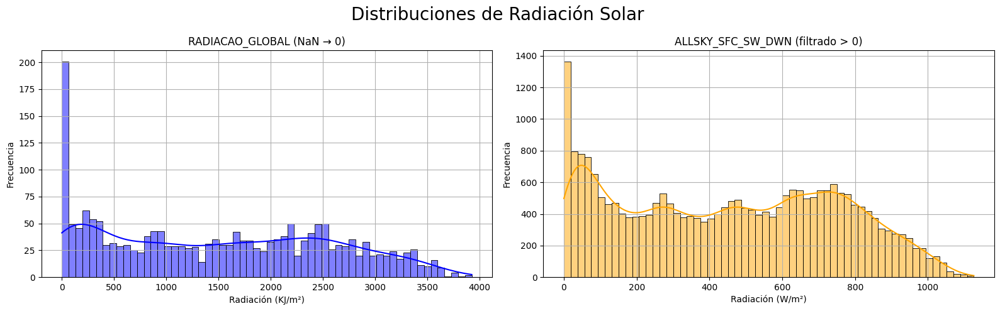

In [459]:
df_comparado['RADIACAO_GLOBAL'] = df_comparado['RADIACAO_GLOBAL'].fillna(0)
rad1 = df_comparado['RADIACAO_GLOBAL']
rad1 = rad1[rad1 > 0]

rad2 = df_comparado['ALLSKY_SFC_SW_DWN']
rad2 = rad2[rad2 > 0]
fig, axes = plt.subplots(1, 2, figsize=(16, 5))

sns.histplot(rad1, bins=60, kde=True, ax=axes[0], color='blue')
axes[0].set_title('RADIACAO_GLOBAL (NaN → 0)')
axes[0].set_xlabel('Radiación (KJ/m²)')
axes[0].set_ylabel('Frecuencia')
axes[0].grid(True)

sns.histplot(rad2, bins=60, kde=True, ax=axes[1], color='orange')
axes[1].set_title('ALLSKY_SFC_SW_DWN (filtrado > 0)')
axes[1].set_xlabel('Radiación (W/m²)')
axes[1].set_ylabel('Frecuencia')
axes[1].grid(True)
plt.suptitle("Distribuciones de Radiación Solar ", fontsize=20)
plt.tight_layout()
plt.show()

In [460]:
stat_inmet, p_inmet = jarque_bera(df_comparado['RADIACAO_GLOBAL'])
stat_nasa, p_nasa = jarque_bera(df_comparado['ALLSKY_SFC_SW_DWN'])
print(f" Jarque-Bera - INMET")
print(f"  Estadístico: {stat_inmet:.4f} | p-valor: {p_inmet:.4e} → {'Distribución normal' if p_inmet > 0.05 else 'NO normal'}")
print(f"\n Jarque-Bera - NASA")
print(f"  Estadístico: {stat_nasa:.4f} | p-valor: {p_nasa:.4e} → {'Distribución normal' if p_nasa > 0.05 else 'NO normal'}")


 Jarque-Bera - INMET
  Estadístico: 7165175.5900 | p-valor: 0.0000e+00 → NO normal

 Jarque-Bera - NASA
  Estadístico: 6598.1041 | p-valor: 0.0000e+00 → NO normal


## Prueba de Kolmogórov-Smirnov para Dos Muestras

La **prueba de Kolmogórov-Smirnov (KS)** de dos muestras es una prueba **no paramétrica** utilizada para comparar si **dos distribuciones de datos continuos** provienen de la misma población.

###  Hipótesis:

- $H_0$: Ambas muestras provienen de la misma distribución.
- $H_1$: Las muestras provienen de distribuciones diferentes.

###  Estadístico de Prueba:

La fórmula del estadístico de KS es:

$$
D = \sup_x |F_1(x) - F_2(x)|
$$

Donde:

- $F_1(x)$ y $F_2(x)$ son las funciones de distribución empíricas (ECDF) de cada muestra.
- $\sup$ representa el máximo valor de la diferencia absoluta entre las dos ECDFs.

In [461]:
ks_stat, p_value = ks_2samp(
   df_comparado['RADIACAO_GLOBAL'],
    df_comparado['ALLSKY_SFC_SW_DWN']
)
print(f"KS Statistic: {ks_stat:.4f}")
print(f"Valor p: {p_value:.4f}")

if p_value < 0.05:
    print("Las distribuciones de radiación entre INMET y NASA son estadísticamente diferentes.")
else:
    print("No se detectan diferencias significativas entre las distribuciones de radiación.")


KS Statistic: 0.4278
Valor p: 0.0000
Las distribuciones de radiación entre INMET y NASA son estadísticamente diferentes.


####  $\color{red}{\huge\bf\mathcal{Imputación\ INMET}}$

**Imputación usando promedio estacional**

## Regla de Imputación Estacional

Supongamos que tienes una serie de datos:

- $R_i$: valor de radiación en la observación $i$
- $d_i$: día del año de la observación $i$ (de 1 a 366)
- $h_i$: hora del día de la observación $i$ (de 0 a 23)

Para cada observación con valor faltante $R_i = 0$, la imputación es:

$$
\hat{R}_i = \frac{1}{n_{d_i,h_i}} \sum_{j \in G(d_i,h_i)} R_j
$$

###  Donde:

- $\hat{R}_i$ es el valor imputado para la observación $i$
- $G(d_i, h_i)$ es el conjunto de observaciones $j$ donde $R_j > 0$, y el día y la hora coinciden con $d_i, h_i$
- $n_{d_i,h_i}$ es el número de valores disponibles en ese grupo

> Si no existen datos en ese grupo:

$$
\hat{R}_i = 0
$$

Fuentes: https://www.sciencedirect.com/science/article/pii/S2213138821007785?ref=pdf_download&fr=RR-2&rr=9266d1c478c4a4cd 

 https://www.mdpi.com/2071-1050/15/13/10609 

_Identificar el patrón típico de radiación para cada hora del día usando valores históricos disponibles del mismo día y mes, y luego aplicar ese valor como estimación cuando hay datos faltantes_

In [462]:
df_comparado['RADIACAO_GLOBAL_IMPUTADA'] = df_comparado['RADIACAO_GLOBAL'].replace(0, pd.NA)
df_comparado['datetime'] = pd.to_datetime(df_comparado['datetime'])
df_comparado['dayofyear'] = df_comparado['datetime'].dt.dayofyear
df_comparado['hour'] = df_comparado['datetime'].dt.hour

tabla_promedios = df_comparado.groupby(['dayofyear', 'hour'])['RADIACAO_GLOBAL_IMPUTADA'].mean()
def imputar_estacional(row):
    if pd.isna(row['RADIACAO_GLOBAL_IMPUTADA']):
        return tabla_promedios.get((int(row['dayofyear']), int(row['hour'])), 0)
    else:
        return row['RADIACAO_GLOBAL_IMPUTADA']
df_comparado['RADIACAO_GLOBAL_IMPUTADA'] = df_comparado.apply(imputar_estacional, axis=1)
df_comparado['RADIACAO_GLOBAL_IMPUTADA'] = df_comparado['RADIACAO_GLOBAL_IMPUTADA'].fillna(0)
print(df_comparado.shape)
df_comparado.tail(20)

(54024, 6)


,datetime,RADIACAO_GLOBAL,ALLSKY_SFC_SW_DWN,RADIACAO_GLOBAL_IMPUTADA,dayofyear,hour
54004,2025-02-28 04:00:00,0.0,-999.0,0.0,59,4
54005,2025-02-28 05:00:00,0.0,-999.0,0.0,59,5
54006,2025-02-28 06:00:00,0.0,-999.0,0.0,59,6
54007,2025-02-28 07:00:00,0.0,-999.0,0.0,59,7
54008,2025-02-28 08:00:00,0.0,-999.0,0.0,59,8
54009,2025-02-28 09:00:00,0.0,-999.0,0.0,59,9
54010,2025-02-28 10:00:00,0.0,-999.0,0.0,59,10
54011,2025-02-28 11:00:00,0.0,-999.0,0.0,59,11
54012,2025-02-28 12:00:00,0.0,-999.0,1749.0,59,12
54013,2025-02-28 13:00:00,0.0,-999.0,0.0,59,13


In [463]:
fig = go.Figure()
fig.add_trace(go.Scatter(
    x=df_comparado['datetime'],
    y=df_comparado['RADIACAO_GLOBAL_IMPUTADA'],
    mode='lines',
    name='INMET-IMPUTADA',
    line=dict(color='orange'),
    opacity=0.7
))
fig.add_trace(go.Scatter(
    x=df_comparado['datetime'],
    y=df_comparado['RADIACAO_GLOBAL'],
    mode='lines',
    name='INMET-SIN IMPUTAR',
    line=dict(color='blue'),
    opacity=0.7
))
fig.update_layout(
    title='Evolución de Radiación INMET - Imputación Promedio Estacional (2019-2025)',
    xaxis_title='Fecha y Hora',
    yaxis_title='Radiación (KJ/m²)',
    legend_title='Fuente',
    template='plotly_white',
    height=500,
    width=1100
)
fig.show()

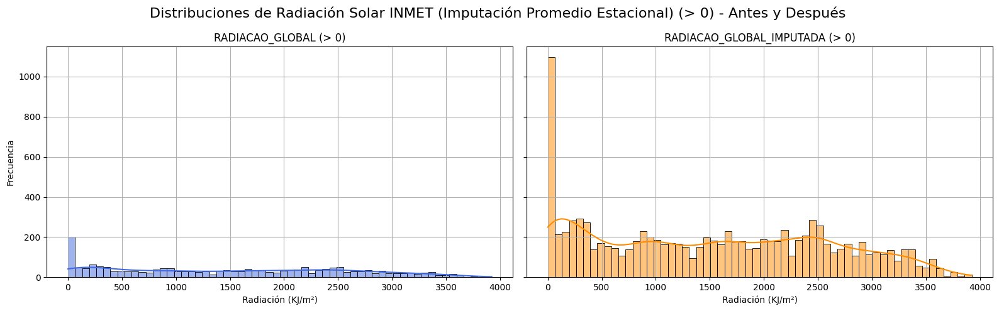

Kolmogorov-Smirnov Test (Distribución Original vs Imputada):
Estadístico KS: 0.0153
p-valor: 8.3915e-01
No se rechaza H0 → Las distribuciones son estadísticamente similares.


In [464]:
rad_orig = df_comparado['RADIACAO_GLOBAL'][df_comparado['RADIACAO_GLOBAL'] > 0]
rad_imp = df_comparado['RADIACAO_GLOBAL_IMPUTADA'][df_comparado['RADIACAO_GLOBAL_IMPUTADA'] > 0]

fig, axes = plt.subplots(1, 2, figsize=(16, 5), sharey=True)

sns.histplot(rad_orig, bins=60, kde=True, color='royalblue', ax=axes[0])
axes[0].set_title('RADIACAO_GLOBAL (> 0)')
axes[0].set_xlabel('Radiación (KJ/m²)')
axes[0].set_ylabel('Frecuencia')
axes[0].grid(True)

sns.histplot(rad_imp, bins=60, kde=True, color='darkorange', ax=axes[1])
axes[1].set_title('RADIACAO_GLOBAL_IMPUTADA (> 0)')
axes[1].set_xlabel('Radiación (KJ/m²)')
axes[1].set_ylabel('')
axes[1].grid(True)

fig.suptitle('Distribuciones de Radiación Solar INMET (Imputación Promedio Estacional) (> 0) - Antes y Después ', fontsize=16)
plt.tight_layout()
plt.show()

rad_orig = df_comparado['RADIACAO_GLOBAL'][df_comparado['RADIACAO_GLOBAL'] > 0]
rad_imp = df_comparado['RADIACAO_GLOBAL_IMPUTADA'][df_comparado['RADIACAO_GLOBAL_IMPUTADA'] > 0]
stat_ks, p_ks = ks_2samp(rad_orig, rad_imp)
print("Kolmogorov-Smirnov Test (Distribución Original vs Imputada):")
print(f"Estadístico KS: {stat_ks:.4f}")
print(f"p-valor: {p_ks:.4e}")
if p_ks > 0.05:
    print("No se rechaza H0 → Las distribuciones son estadísticamente similares.")
else:
    print("Se rechaza H0 → Las distribuciones son diferentes.")

**Imputación interpolación temporal**

##  Interpolación Temporal Lineal

La interpolación temporal lineal se utiliza para estimar un valor faltante \( y(t) \) entre dos puntos conocidos \( y(t_0) \) y \( y(t_1) \), en función del tiempo:

$$
\hat{y}(t) = y(t_0) + \left( \frac{y(t_1) - y(t_0)}{t_1 - t_0} \right) \cdot (t - t_0)
$$


Donde:

- $\hat{y}(t)$: valor interpolado en el tiempo \( t \)
- $y(t_0)$: valor anterior conocido (antes de la brecha)
- $y(t_1)$: valor posterior conocido (después de la brecha)
- $t$: tiempo del dato faltante
- $t_0$, \( t_1 \): tiempos de los valores vecinos conocidos

Asume un **cambio lineal constante** entre los dos valores adyacentes, y es especialmente para series temporales **continuas y cronológicas**, como la radiación solar horaria.

Fuente: https://www.sciencedirect.com/science/article/pii/S0196890423001267?casa_token=W9s3cY6FhqEAAAAA:tucR1tz7uEtZti1aSUGTTHg6Wu7M8mC7NvatLi0JWvnvmA9XPy6BBxCew64bNb9Zdg16MKEYxQ 

https://www.mdpi.com/1424-8220/14/11/20382 


In [465]:
df_comparado['RADIACAO_GLOBAL_INTERPOLADA'] = df_comparado['RADIACAO_GLOBAL'].replace(0, pd.NA)
df_comparado = df_comparado.set_index('datetime')
df_comparado['RADIACAO_GLOBAL_INTERPOLADA'] = df_comparado['RADIACAO_GLOBAL_INTERPOLADA'].interpolate(method='time')
df_comparado['RADIACAO_GLOBAL_INTERPOLADA'] = df_comparado['RADIACAO_GLOBAL_INTERPOLADA'].fillna(0)
df_comparado = df_comparado.reset_index()
df_comparado.tail(10)

,datetime,RADIACAO_GLOBAL,ALLSKY_SFC_SW_DWN,RADIACAO_GLOBAL_IMPUTADA,dayofyear,hour,RADIACAO_GLOBAL_INTERPOLADA
54014,2025-02-28 14:00:00,0.0,-999.0,2989.0,59,14,0.0
54015,2025-02-28 15:00:00,0.0,-999.0,0.0,59,15,0.0
54016,2025-02-28 16:00:00,0.0,-999.0,1930.0,59,16,0.0
54017,2025-02-28 17:00:00,0.0,-999.0,0.0,59,17,0.0
54018,2025-02-28 18:00:00,0.0,-999.0,3146.0,59,18,0.0
54019,2025-02-28 19:00:00,0.0,-999.0,0.0,59,19,0.0
54020,2025-02-28 20:00:00,0.0,-999.0,0.0,59,20,0.0
54021,2025-02-28 21:00:00,0.0,-999.0,0.0,59,21,0.0
54022,2025-02-28 22:00:00,0.0,-999.0,97.0,59,22,0.0
54023,2025-02-28 23:00:00,0.0,-999.0,0.0,59,23,0.0


In [466]:
fig = go.Figure()
fig.add_trace(go.Scatter(
    x=df_comparado['datetime'],
    y=df_comparado['RADIACAO_GLOBAL_INTERPOLADA'],
    mode='lines',
    name='INMET-IMPUTADA',
    line=dict(color='orange'),
    opacity=0.7
))
fig.add_trace(go.Scatter(
    x=df_comparado['datetime'],
    y=df_comparado['RADIACAO_GLOBAL'],
    mode='lines',
    name='INMET- SIN IMPUTADAR',
    line=dict(color='blue'),
    opacity=0.7
))
fig.update_layout(
    title='Evolución de Radiación INMET - Imputación Interpolación Temporal (2019-2025)',
    xaxis_title='Fecha y Hora',
    yaxis_title='Radiación (KJ/m²)',
    legend_title='Fuente',
    template='plotly_white',
    height=500,
    width=1100
)
fig.show()

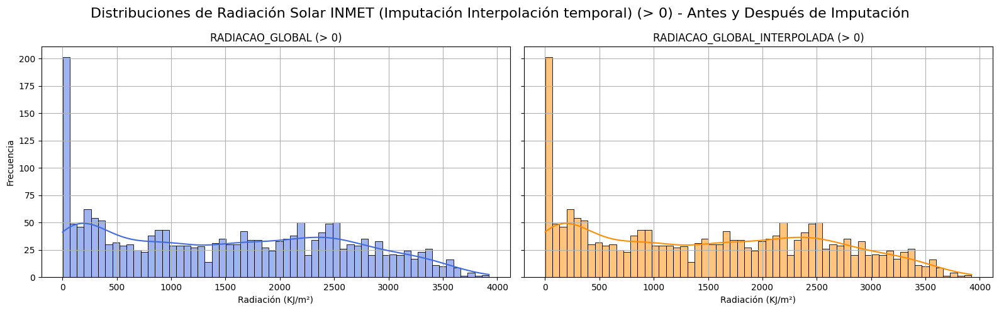

Kolmogorov-Smirnov Test (Distribución Original vs Imputada):
Estadístico KS: 0.0000
p-valor: 1.0000e+00
No se rechaza H0 → Las distribuciones son estadísticamente similares.


In [467]:
rad_orig = df_comparado['RADIACAO_GLOBAL'][df_comparado['RADIACAO_GLOBAL'] > 0]
rad_imp = df_comparado['RADIACAO_GLOBAL_INTERPOLADA'][df_comparado['RADIACAO_GLOBAL_INTERPOLADA'] > 0]

fig, axes = plt.subplots(1, 2, figsize=(16, 5), sharey=True)

sns.histplot(rad_orig, bins=60, kde=True, color='royalblue', ax=axes[0])
axes[0].set_title('RADIACAO_GLOBAL (> 0)')
axes[0].set_xlabel('Radiación (KJ/m²)')
axes[0].set_ylabel('Frecuencia')
axes[0].grid(True)

sns.histplot(rad_imp, bins=60, kde=True, color='darkorange', ax=axes[1])
axes[1].set_title('RADIACAO_GLOBAL_INTERPOLADA (> 0)')
axes[1].set_xlabel('Radiación (KJ/m²)')
axes[1].set_ylabel('')
axes[1].grid(True)

fig.suptitle('Distribuciones de Radiación Solar INMET (Imputación Interpolación temporal) (> 0) - Antes y Después de Imputación', fontsize=16)
plt.tight_layout()
plt.show()

rad_orig = df_comparado['RADIACAO_GLOBAL'][df_comparado['RADIACAO_GLOBAL'] > 0]
rad_imp = df_comparado['RADIACAO_GLOBAL_INTERPOLADA'][df_comparado['RADIACAO_GLOBAL_INTERPOLADA'] > 0]
stat_ks, p_ks = ks_2samp(rad_orig, rad_imp)
print("Kolmogorov-Smirnov Test (Distribución Original vs Imputada):")
print(f"Estadístico KS: {stat_ks:.4f}")
print(f"p-valor: {p_ks:.4e}")
if p_ks > 0.05:
    print("No se rechaza H0 → Las distribuciones son estadísticamente similares.")
else:
    print("Se rechaza H0 → Las distribuciones son diferentes.")

####  $\color{red}{\huge\bf\mathcal{Imputación\ NASA}}$

**Imputación usando promedio estacional**

In [468]:
df_comparado['ALLSKY_SFC_SW_DWN_IMPUTACION'] = df_comparado['ALLSKY_SFC_SW_DWN'].copy()
df_comparado['ALLSKY_SFC_SW_DWN_IMPUTACION'] = df_comparado['ALLSKY_SFC_SW_DWN_IMPUTACION'].replace(-999.0, pd.NA)
df_comparado['datetime'] = pd.to_datetime(df_comparado['datetime'])
df_comparado['dayofyear'] = df_comparado['datetime'].dt.dayofyear
df_comparado['hour'] = df_comparado['datetime'].dt.hour
tabla_promedios_nasa = df_comparado.groupby(['dayofyear', 'hour'])['ALLSKY_SFC_SW_DWN_IMPUTACION'].mean()
def imputar_estacional_nasa(row):
    if pd.isna(row['ALLSKY_SFC_SW_DWN_IMPUTACION']):
        return tabla_promedios_nasa.get((int(row['dayofyear']), int(row['hour'])), 0)
    else:
        return row['ALLSKY_SFC_SW_DWN_IMPUTACION']
df_comparado['ALLSKY_SFC_SW_DWN_ESTACIONAL'] = df_comparado.apply(imputar_estacional_nasa, axis=1)
df_comparado.tail(10)

,datetime,RADIACAO_GLOBAL,ALLSKY_SFC_SW_DWN,RADIACAO_GLOBAL_IMPUTADA,dayofyear,hour,RADIACAO_GLOBAL_INTERPOLADA,ALLSKY_SFC_SW_DWN_IMPUTACION,ALLSKY_SFC_SW_DWN_ESTACIONAL
54014,2025-02-28 14:00:00,0.0,-999.0,2989.0,59,14,0.0,<NA>,702.513333
54015,2025-02-28 15:00:00,0.0,-999.0,0.0,59,15,0.0,<NA>,576.180000
54016,2025-02-28 16:00:00,0.0,-999.0,1930.0,59,16,0.0,<NA>,383.273333
54017,2025-02-28 17:00:00,0.0,-999.0,0.0,59,17,0.0,<NA>,188.291667
54018,2025-02-28 18:00:00,0.0,-999.0,3146.0,59,18,0.0,<NA>,26.153333
54019,2025-02-28 19:00:00,0.0,-999.0,0.0,59,19,0.0,<NA>,0.000000
54020,2025-02-28 20:00:00,0.0,-999.0,0.0,59,20,0.0,<NA>,0.000000
54021,2025-02-28 21:00:00,0.0,-999.0,0.0,59,21,0.0,<NA>,0.000000
54022,2025-02-28 22:00:00,0.0,-999.0,97.0,59,22,0.0,<NA>,0.000000
54023,2025-02-28 23:00:00,0.0,-999.0,0.0,59,23,0.0,<NA>,0.000000


In [469]:
fig = go.Figure()
fig.add_trace(go.Scatter(
    x=df_comparado['datetime'],
    y=df_comparado['ALLSKY_SFC_SW_DWN_ESTACIONAL'],
    mode='lines',
    name='INMET-IMPUTADA',
    line=dict(color='blue'),
    opacity=0.7
))
fig.add_trace(go.Scatter(
    x=df_comparado['datetime'],
    y=df_comparado['ALLSKY_SFC_SW_DWN'],
    mode='lines',
    name='INMET-SIN IMPUTAR',
    line=dict(color='orange'),
    opacity=0.7
))
fig.update_layout(
    title='Evolución de Radiación NASA - (Imputación Promedio Estacional) (2019-2025)',
    xaxis_title='Fecha y Hora',
    yaxis_title='Radiación (KJ/m²)',
    legend_title='Fuente',
    template='plotly_white',
    height=500,
    width=1100
)
fig.show()

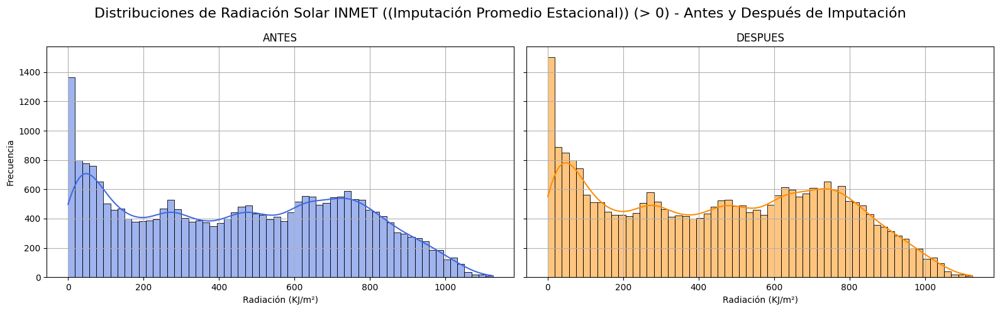

Kolmogorov-Smirnov Test (Distribución Original vs Imputada):
Estadístico KS: 0.0034
p-valor: 9.9835e-01
No se rechaza H0 → Las distribuciones son estadísticamente similares.


In [470]:
rad_orig = df_comparado['ALLSKY_SFC_SW_DWN'][df_comparado['ALLSKY_SFC_SW_DWN'] > 0]
rad_imp = df_comparado['ALLSKY_SFC_SW_DWN_ESTACIONAL'][df_comparado['ALLSKY_SFC_SW_DWN_ESTACIONAL'] > 0]

fig, axes = plt.subplots(1, 2, figsize=(16, 5), sharey=True)

sns.histplot(rad_orig, bins=60, kde=True, color='royalblue', ax=axes[0])
axes[0].set_title('ANTES')
axes[0].set_xlabel('Radiación (KJ/m²)')
axes[0].set_ylabel('Frecuencia')
axes[0].grid(True)

sns.histplot(rad_imp, bins=60, kde=True, color='darkorange', ax=axes[1])
axes[1].set_title('DESPUES')
axes[1].set_xlabel('Radiación (KJ/m²)')
axes[1].set_ylabel('')
axes[1].grid(True)

fig.suptitle('Distribuciones de Radiación Solar INMET ((Imputación Promedio Estacional)) (> 0) - Antes y Después de Imputación', fontsize=16)
plt.tight_layout()
plt.show()

rad_orig = df_comparado['ALLSKY_SFC_SW_DWN'][df_comparado['ALLSKY_SFC_SW_DWN'] > 0]
rad_imp = df_comparado['ALLSKY_SFC_SW_DWN_ESTACIONAL'][df_comparado['ALLSKY_SFC_SW_DWN_ESTACIONAL'] > 0]
stat_ks, p_ks = ks_2samp(rad_orig, rad_imp)
print("Kolmogorov-Smirnov Test (Distribución Original vs Imputada):")
print(f"Estadístico KS: {stat_ks:.4f}")
print(f"p-valor: {p_ks:.4e}")
if p_ks > 0.05:
    print("No se rechaza H0 → Las distribuciones son estadísticamente similares.")
else:
    print("Se rechaza H0 → Las distribuciones son diferentes.")

**Interpolación Temporal**

In [471]:
#df_comparado['ALLSKY_SFC_SW_DWN'] = df_comparado['ALLSKY_SFC_SW_DWN'].replace(-999.0, pd.NA)
df_comparado['datetime'] = pd.to_datetime(df_comparado['datetime'])
df_comparado = df_comparado.set_index('datetime')
df_comparado['ALLSKY_SFC_SW_DWN_INTERPOLADA'] = df_comparado['ALLSKY_SFC_SW_DWN'].interpolate(method='time')
df_comparado['ALLSKY_SFC_SW_DWN_INTERPOLADA'] = df_comparado['ALLSKY_SFC_SW_DWN_INTERPOLADA'].fillna(0)
df_comparado = df_comparado.reset_index()
df_comparado[['datetime', 'ALLSKY_SFC_SW_DWN', 'ALLSKY_SFC_SW_DWN_INTERPOLADA']].tail(10)
df_comparado.tail(10)

,datetime,RADIACAO_GLOBAL,ALLSKY_SFC_SW_DWN,RADIACAO_GLOBAL_IMPUTADA,dayofyear,hour,RADIACAO_GLOBAL_INTERPOLADA,ALLSKY_SFC_SW_DWN_IMPUTACION,ALLSKY_SFC_SW_DWN_ESTACIONAL,ALLSKY_SFC_SW_DWN_INTERPOLADA
54014,2025-02-28 14:00:00,0.0,-999.0,2989.0,59,14,0.0,<NA>,702.513333,-999.0
54015,2025-02-28 15:00:00,0.0,-999.0,0.0,59,15,0.0,<NA>,576.180000,-999.0
54016,2025-02-28 16:00:00,0.0,-999.0,1930.0,59,16,0.0,<NA>,383.273333,-999.0
54017,2025-02-28 17:00:00,0.0,-999.0,0.0,59,17,0.0,<NA>,188.291667,-999.0
54018,2025-02-28 18:00:00,0.0,-999.0,3146.0,59,18,0.0,<NA>,26.153333,-999.0
54019,2025-02-28 19:00:00,0.0,-999.0,0.0,59,19,0.0,<NA>,0.000000,-999.0
54020,2025-02-28 20:00:00,0.0,-999.0,0.0,59,20,0.0,<NA>,0.000000,-999.0
54021,2025-02-28 21:00:00,0.0,-999.0,0.0,59,21,0.0,<NA>,0.000000,-999.0
54022,2025-02-28 22:00:00,0.0,-999.0,97.0,59,22,0.0,<NA>,0.000000,-999.0
54023,2025-02-28 23:00:00,0.0,-999.0,0.0,59,23,0.0,<NA>,0.000000,-999.0


In [472]:
fig = go.Figure()
fig.add_trace(go.Scatter(
    x=df_comparado['datetime'],
    y=df_comparado['ALLSKY_SFC_SW_DWN'],
    mode='lines',
    name='INMET-SIN IMPUTARr',
    line=dict(color='blue'),
    opacity=0.7
))
fig.add_trace(go.Scatter(
    x=df_comparado['datetime'],
    y=df_comparado['ALLSKY_SFC_SW_DWN_INTERPOLADA'],
    mode='lines',
    name='INMET-IMPUTADA',
    line=dict(color='orange'),
    opacity=0.7
))
fig.update_layout(
    title='Evolución de Radiación NASA - Imputación Interpolación Temporal (2019-2025)',
    xaxis_title='Fecha y Hora',
    yaxis_title='Radiación (KJ/m²)',
    legend_title='Fuente',
    template='plotly_white',
    height=500,
    width=1100
)
fig.show()

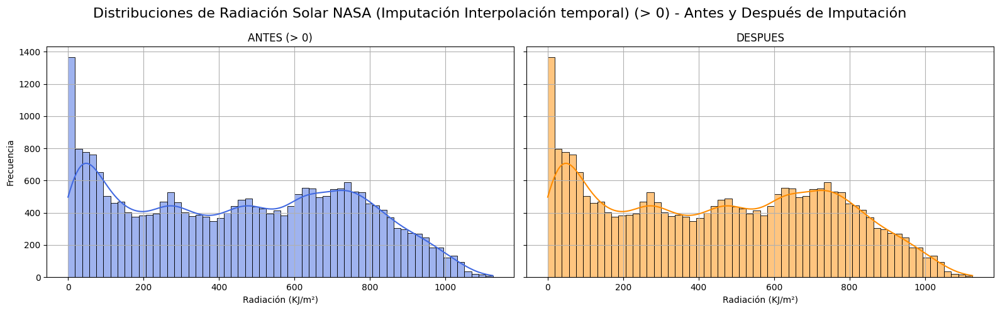

Kolmogorov-Smirnov Test (Distribución Original vs Imputada):
Estadístico KS: 0.0000
p-valor: 1.0000e+00
No se rechaza H0 → Las distribuciones son estadísticamente similares.


In [473]:
rad_orig = df_comparado['ALLSKY_SFC_SW_DWN'][df_comparado['ALLSKY_SFC_SW_DWN'] > 0]
rad_imp = df_comparado['ALLSKY_SFC_SW_DWN_INTERPOLADA'][df_comparado['ALLSKY_SFC_SW_DWN_INTERPOLADA'] > 0]

fig, axes = plt.subplots(1, 2, figsize=(16, 5), sharey=True)

sns.histplot(rad_orig, bins=60, kde=True, color='royalblue', ax=axes[0])
axes[0].set_title('ANTES (> 0)')
axes[0].set_xlabel('Radiación (KJ/m²)')
axes[0].set_ylabel('Frecuencia')
axes[0].grid(True)

sns.histplot(rad_imp, bins=60, kde=True, color='darkorange', ax=axes[1])
axes[1].set_title('DESPUES')
axes[1].set_xlabel('Radiación (KJ/m²)')
axes[1].set_ylabel('')
axes[1].grid(True)

fig.suptitle('Distribuciones de Radiación Solar NASA (Imputación Interpolación temporal) (> 0) - Antes y Después de Imputación', fontsize=16)
plt.tight_layout()
plt.show()

rad_orig = df_comparado['ALLSKY_SFC_SW_DWN'][df_comparado['ALLSKY_SFC_SW_DWN'] > 0]
rad_imp = df_comparado['ALLSKY_SFC_SW_DWN_INTERPOLADA'][df_comparado['ALLSKY_SFC_SW_DWN_INTERPOLADA'] > 0]
stat_ks, p_ks = ks_2samp(rad_orig, rad_imp)
print("Kolmogorov-Smirnov Test (Distribución Original vs Imputada):")
print(f"Estadístico KS: {stat_ks:.4f}")
print(f"p-valor: {p_ks:.4e}")
if p_ks > 0.05:
    print("No se rechaza H0 → Las distribuciones son estadísticamente similares.")
else:
    print("Se rechaza H0 → Las distribuciones son diferentes.")

#  $\color{blue}{\huge\bf\mathcal{EDA\ Series\ Imputadas}}$

In [474]:
fig = go.Figure()
fig.add_trace(go.Scatter(
    x=df_comparado['datetime'],
    y=df_comparado['RADIACAO_GLOBAL_IMPUTADA'],
    mode='lines',
    name='INMET',
    line=dict(color='blue'),
    opacity=0.7
))
fig.add_trace(go.Scatter(
    x=df_comparado['datetime'],
    y=df_comparado['ALLSKY_SFC_SW_DWN_ESTACIONAL'],
    mode='lines',
    name='NASA',
    line=dict(color='orange'),
    opacity=0.7
))
fig.update_layout(
    title='Evolución de Radiación Horaria - INMET vs. NASA (2019-2025)',
    xaxis_title='Fecha y Hora',
    yaxis_title='Radiación (KJ/m²)',
    legend_title='Fuente',
    template='plotly_white',
    height=500,
    width=1100
)
fig.show()

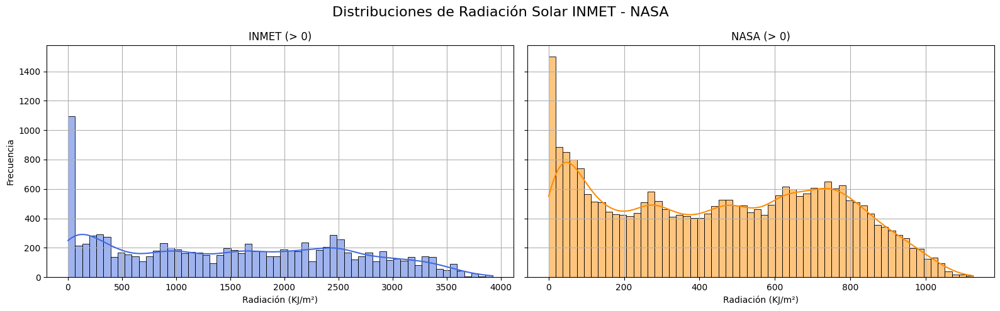

Kolmogorov-Smirnov Test (Distribución Original vs Imputada):
Estadístico KS: 0.6057
p-valor: 0.0000e+00
Se rechaza H0 → Las distribuciones son diferentes.


In [475]:
rad_orig = df_comparado['RADIACAO_GLOBAL_IMPUTADA'][df_comparado['RADIACAO_GLOBAL_IMPUTADA'] > 0]
rad_imp = df_comparado['ALLSKY_SFC_SW_DWN_ESTACIONAL'][df_comparado['ALLSKY_SFC_SW_DWN_ESTACIONAL'] > 0]

fig, axes = plt.subplots(1, 2, figsize=(16, 5), sharey=True)

sns.histplot(rad_orig, bins=60, kde=True, color='royalblue', ax=axes[0])
axes[0].set_title('INMET (> 0)')
axes[0].set_xlabel('Radiación (KJ/m²)')
axes[0].set_ylabel('Frecuencia')
axes[0].grid(True)

sns.histplot(rad_imp, bins=60, kde=True, color='darkorange', ax=axes[1])
axes[1].set_title('NASA (> 0)')
axes[1].set_xlabel('Radiación (KJ/m²)')
axes[1].set_ylabel('')
axes[1].grid(True)

fig.suptitle('Distribuciones de Radiación Solar INMET - NASA', fontsize=16)
plt.tight_layout()
plt.show()

rad_orig = df_comparado['RADIACAO_GLOBAL_IMPUTADA'][df_comparado['RADIACAO_GLOBAL_IMPUTADA'] > 0]
rad_imp = df_comparado['ALLSKY_SFC_SW_DWN_ESTACIONAL'][df_comparado['ALLSKY_SFC_SW_DWN_ESTACIONAL'] > 0]
stat_ks, p_ks = ks_2samp(rad_orig, rad_imp)
print("Kolmogorov-Smirnov Test (Distribución Original vs Imputada):")
print(f"Estadístico KS: {stat_ks:.4f}")
print(f"p-valor: {p_ks:.4e}")
if p_ks > 0.05:
    print("No se rechaza H0 → Las distribuciones son estadísticamente similares.")
else:
    print("Se rechaza H0 → Las distribuciones son diferentes.")